In [1]:
import pandas as pd
import numpy as np
import math

import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px
import plotly.figure_factory as ff

from tqdm import tqdm, trange

/opt/anaconda3/lib/python3.9/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.9.1dev-CAPI-1.14.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


In [3]:
def function_data_historical(df):
  df = df[df['SITUACION_MATRICULA']==1]
  df = df[['SEMESTRE',
                        'id',
                        'COD_ESTUDIANTE',
                        'ESCUELA_PROFESIONAL',
                        'CANT_CURSO_MAT_CICLO_01', 'CANT_CURSO_MAT_CICLO_02', 'CANT_CURSO_MAT_CICLO_03',
                        'CANT_CURSO_MAT_CICLO_04', 'CANT_CURSO_MAT_CICLO_05', 'CANT_CURSO_MAT_CICLO_06',
                        'CANT_CURSO_MAT_CICLO_07', 'CANT_CURSO_MAT_CICLO_08', 'CANT_CURSO_MAT_CICLO_09',
                        'CANT_CURSO_MAT_CICLO_10', 'CANT_CURSO_MAT_CICLO_11', 'CANT_CURSO_MAT_CICLO_12',
                        'CANT_CURSO_MAT_CICLO_13', 'CANT_CURSO_MAT_CICLO_14',
                        'CANT_CURSO_MAT_DES_CICLO_01', 'CANT_CURSO_MAT_DES_CICLO_02', 'CANT_CURSO_MAT_DES_CICLO_03',
                        'CANT_CURSO_MAT_DES_CICLO_04', 'CANT_CURSO_MAT_DES_CICLO_05', 'CANT_CURSO_MAT_DES_CICLO_06',
                        'CANT_CURSO_MAT_DES_CICLO_07', 'CANT_CURSO_MAT_DES_CICLO_08', 'CANT_CURSO_MAT_DES_CICLO_09',
                        'CANT_CURSO_MAT_DES_CICLO_10', 'CANT_CURSO_MAT_DES_CICLO_11', 'CANT_CURSO_MAT_DES_CICLO_12',
                        'CANT_CURSO_MAT_DES_CICLO_13', 'CANT_CURSO_MAT_DES_CICLO_14'
                        ]]
  df = df.reset_index(drop=True)

  df = df.groupby(['id']).agg(
                #        NUM_MATRICULAS=('SEMESTRE','count'),
                        COD_ESTUDIANTE=('COD_ESTUDIANTE','max'),
                        ESCUELA_PROFESIONAL=('ESCUELA_PROFESIONAL','max'),
                        NUM_CURSOS_APR_CICLO_01=('CANT_CURSO_MAT_CICLO_01','sum'),
                        NUM_CURSOS_APR_CICLO_02=('CANT_CURSO_MAT_CICLO_02','sum'),
                        NUM_CURSOS_APR_CICLO_03=('CANT_CURSO_MAT_CICLO_03','sum'),
                        NUM_CURSOS_APR_CICLO_04=('CANT_CURSO_MAT_CICLO_04','sum'),
                        NUM_CURSOS_APR_CICLO_05=('CANT_CURSO_MAT_CICLO_05','sum'),
                        NUM_CURSOS_APR_CICLO_06=('CANT_CURSO_MAT_CICLO_06','sum'),
                        NUM_CURSOS_APR_CICLO_07=('CANT_CURSO_MAT_CICLO_07','sum'),
                        NUM_CURSOS_APR_CICLO_08=('CANT_CURSO_MAT_CICLO_08','sum'),
                        NUM_CURSOS_APR_CICLO_09=('CANT_CURSO_MAT_CICLO_09','sum'),
                        NUM_CURSOS_APR_CICLO_10=('CANT_CURSO_MAT_CICLO_10','sum'),
                        NUM_CURSOS_APR_CICLO_11=('CANT_CURSO_MAT_CICLO_11','sum'),
                        NUM_CURSOS_APR_CICLO_12=('CANT_CURSO_MAT_CICLO_12','sum'),
                        NUM_CURSOS_APR_CICLO_13=('CANT_CURSO_MAT_CICLO_13','sum'),
                        NUM_CURSOS_APR_CICLO_14=('CANT_CURSO_MAT_CICLO_14','sum'),
                #         NUM_CURSOS_DES_CICLO_01=('CANT_CURSO_MAT_DES_CICLO_01','sum'),
                #         NUM_CURSOS_DES_CICLO_02=('CANT_CURSO_MAT_DES_CICLO_02','sum'),
                #         NUM_CURSOS_DES_CICLO_03=('CANT_CURSO_MAT_DES_CICLO_03','sum'),
                #         NUM_CURSOS_DES_CICLO_04=('CANT_CURSO_MAT_DES_CICLO_04','sum'),
                #         NUM_CURSOS_DES_CICLO_05=('CANT_CURSO_MAT_DES_CICLO_05','sum'),
                #         NUM_CURSOS_DES_CICLO_06=('CANT_CURSO_MAT_DES_CICLO_06','sum'),
                #         NUM_CURSOS_DES_CICLO_07=('CANT_CURSO_MAT_DES_CICLO_07','sum'),
                #         NUM_CURSOS_DES_CICLO_08=('CANT_CURSO_MAT_DES_CICLO_08','sum'),
                #         NUM_CURSOS_DES_CICLO_09=('CANT_CURSO_MAT_DES_CICLO_09','sum'),
                #         NUM_CURSOS_DES_CICLO_10=('CANT_CURSO_MAT_DES_CICLO_10','sum'),
                #         NUM_CURSOS_DES_CICLO_11=('CANT_CURSO_MAT_DES_CICLO_11','sum'),
                #         NUM_CURSOS_DES_CICLO_12=('CANT_CURSO_MAT_DES_CICLO_12','sum'),
                #         NUM_CURSOS_DES_CICLO_13=('CANT_CURSO_MAT_DES_CICLO_13','sum'),
                #         NUM_CURSOS_DES_CICLO_14=('CANT_CURSO_MAT_DES_CICLO_14','sum'),
      ).sort_values(by=['COD_ESTUDIANTE'], ascending=False)

  df = df.reset_index(drop=False)
  return df

### Preparación de archivo

Este código en Python utiliza las bibliotecas Pandas y Pickle para trabajar con un archivo de Excel y guardarlo en un archivo de formato pickle.

 - La primera línea establece una variable "file" que contiene la ruta al archivo "DataSet_Tesis_COMPLETO_descompress.xlsx".
 - La segunda línea utiliza el método "read_excel" de pandas para leer el archivo de excel especificado en la variable "file" y almacenar los datos en una variable llamada "data".
 - La tercera línea utiliza el método "to_pickle" de pandas para guardar los datos en un archivo llamado "DataSet_Tesis.pkl" en formato pickle.
 - La cuarta línea utiliza el método "read_pickle" de pandas para cargar los datos del archivo pickle "DataSet_Tesis.pkl" en una variable llamada "data".
 
 
En resumen este código esta leyendo un archivo excel, guardando esa información en un archivo pickle y luego cargando nuevamente esa información desde ese archivo pickle.


In [2]:
# file = 'data/DataSet_Tesis_COMPLETO_descompress.xlsx'
# data = pd.read_excel(file)
# data.to_pickle('DataSet_Tesis.pkl')
data = pd.read_pickle('DataSet_Tesis.pkl')

In [4]:
data.dtypes

SEMESTRE                     object
COD_ESTUDIANTE               object
ESCUELA_PROFESIONAL          object
SITUACION_MATRICULA           int64
CANT_CURSOS_APROBADOS         int64
                             ...   
EDAD_INGRESANTE             float64
DISTRITO_NAC                 object
PROVINCIA_NAC                object
DEPARTAMENTO_NACIMIENTO      object
NUM_INGRESOS_UNIVERSIDAD      int64
Length: 90, dtype: object

In [4]:
data['id'] = data['COD_ESTUDIANTE'] + data['ESCUELA_PROFESIONAL']
data.columns
print(len(data))

# Eliminamos los ciclos de verano
data = data[~data['SEMESTRE'].str.contains('C|O')]
print(len(data))

812720
797769


In [5]:
# Lista de alumnos
alumnos_lista = list(set(data['COD_ESTUDIANTE']))

### Eliminar datos de alumnos que están incompletos

In [6]:
# Data historial del Alumno (evolutivo)
data_historial =  function_data_historical(data)
data_historial.head()

,id,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,NUM_CURSOS_APR_CICLO_01,NUM_CURSOS_APR_CICLO_02,NUM_CURSOS_APR_CICLO_03,NUM_CURSOS_APR_CICLO_04,NUM_CURSOS_APR_CICLO_05,NUM_CURSOS_APR_CICLO_06,NUM_CURSOS_APR_CICLO_07,NUM_CURSOS_APR_CICLO_08,NUM_CURSOS_APR_CICLO_09,NUM_CURSOS_APR_CICLO_10,NUM_CURSOS_APR_CICLO_11,NUM_CURSOS_APR_CICLO_12,NUM_CURSOS_APR_CICLO_13,NUM_CURSOS_APR_CICLO_14
0,alumno9999EDUCACION INICIAL Y PRIMARIA ...,alumno9999,EDUCACION INICIAL Y PRIMARIA,0,0,7,7,7,7,5,6,5,5,0,0,0,0
1,alumno9998ECONOMIA,alumno9998,ECONOMIA,0,0,4,3,4,4,6,3,2,2,0,0,0,0
2,alumno9997ECONOMIA,alumno9997,ECONOMIA,0,0,6,3,6,4,7,3,1,5,0,0,0,0
3,alumno9996ECONOMIA,alumno9996,ECONOMIA,0,0,4,4,5,4,6,3,3,2,0,0,0,0
4,alumno9995ECONOMIA,alumno9995,ECONOMIA,0,0,4,3,5,4,6,3,2,2,0,0,0,0


In [7]:
# Eliminamos Alumnos cuya actividad se registro despues del primer ciclo (son datos sin detalle previo)
alumno_eliminar = data_historial[data_historial['NUM_CURSOS_APR_CICLO_01']==0]['id'].values
print('Alumnos a eliminar (no se registra sus primeros ciclos): '+str(len(alumno_eliminar)))
data = data[~data['id'].isin(alumno_eliminar)].reset_index(drop=True)
len(data)

Alumnos a aliminar (no se registra sus primeros ciclos): 26107


393306

In [8]:
# Reconstruimos data hisorical
data_historial =  function_data_historical(data)
print(len(set(data_historial['id'])))

20747


### Etiquetando a los alumnos que tuvieron al menos una interrupción (abandono) en su proceso educativo

In [9]:
# Identificado alumnos que tuvieron un BREAK

def encontrar_espacios(list_values):
  dejo_universidad = None
  counter = 0
  counter_2 = counter
  previo = -1
  for actual in list_values:
    if previo == 1 and actual == 0:
        dejo_universidad = True
    elif dejo_universidad:
      counter_2 += 1
      if actual == 1:
       return counter_2
    else:
      pass    
    previo = actual
  return counter

data_temp = data[['id',
                  'COD_ESTUDIANTE',
                  'ESCUELA_PROFESIONAL', 
                  'SEMESTRE',
                  'SITUACION_MATRICULA']].pivot(index=['id', 'COD_ESTUDIANTE', 'ESCUELA_PROFESIONAL'], 
                                                columns='SEMESTRE', 
                                                values='SITUACION_MATRICULA')
data_temp = data_temp.reset_index(drop=False)
data_temp['lista'] = data_temp.iloc[:,3:].values.tolist()

data_temp['ABADONO_PERIODOS'] = data_temp['lista'].apply(lambda x: encontrar_espacios(x))
data_temp = data_temp[['id', 'COD_ESTUDIANTE', 'ESCUELA_PROFESIONAL', 'ABADONO_PERIODOS']]

data_temp.head()

SEMESTRE,id,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,ABADONO_PERIODOS
0,alumno10001ADMINISTRACION,alumno10001,ADMINISTRACION,3
1,alumno10003ENFERMERIA,alumno10003,ENFERMERIA,0
2,alumno10004ENFERMERIA,alumno10004,ENFERMERIA,0
3,alumno10007ENFERMERIA,alumno10007,ENFERMERIA,6
4,alumno10008ENFERMERIA,alumno10008,ENFERMERIA,2


In [10]:
data_temp['ABADONO'] = data_temp['ABADONO_PERIODOS'].apply(lambda x: 1 if x>0 else 0)
data_abandono = data_temp.copy()

In [11]:
data_abandono.head()

SEMESTRE,id,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,ABADONO_PERIODOS,ABADONO
0,alumno10001ADMINISTRACION,alumno10001,ADMINISTRACION,3,1
1,alumno10003ENFERMERIA,alumno10003,ENFERMERIA,0,0
2,alumno10004ENFERMERIA,alumno10004,ENFERMERIA,0,0
3,alumno10007ENFERMERIA,alumno10007,ENFERMERIA,6,1
4,alumno10008ENFERMERIA,alumno10008,ENFERMERIA,2,1


In [12]:
abc = data_abandono.groupby(['ABADONO']).agg(NUM_MATRICULAS=('id','count'))
abc_sum = abc['NUM_MATRICULAS'].sum()
abc['per'] = abc['NUM_MATRICULAS']/abc_sum
abc

,NUM_MATRICULAS,per
ABADONO,,
0,20148,0.751258
1,6671,0.248742


## Balanceo de datos - previas

Definiremos 3 grupos de datos, 
- **Datos por definir y a clasificar**: son los que no terminaron, para ello asumimos que son todos lo que estan estudiando, y no terminaron la carrera en el ultimo perido.

Luego con los datos restantes haremos un corte de los primero "n" ciclo, y asumiremos que sera el minimo numero de peridos necesarios para poder hacer una predicción.
- **Datos de entrenamiento**:
- **Datos de muestras**:

In [14]:
# Lista de alumnos que registran matricula en el ultimo semestre
ultimo_semestre = data['SEMESTRE'].max()
set_alumnos_activos_ultimo_semestre = set(data[(data['SITUACION_MATRICULA']==1) & (data['SEMESTRE']==ultimo_semestre)]['id'])
print('Alumnos activos el ultimo semestre ('+ultimo_semestre+'): '+ str(len(set_alumnos_activos_ultimo_semestre)))


Alumnos activos el ultimo semestre (2021-1): 8013


In [15]:
data_historial.head()

,id,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,NUM_CURSOS_APR_CICLO_01,NUM_CURSOS_APR_CICLO_02,NUM_CURSOS_APR_CICLO_03,NUM_CURSOS_APR_CICLO_04,NUM_CURSOS_APR_CICLO_05,NUM_CURSOS_APR_CICLO_06,NUM_CURSOS_APR_CICLO_07,NUM_CURSOS_APR_CICLO_08,NUM_CURSOS_APR_CICLO_09,NUM_CURSOS_APR_CICLO_10,NUM_CURSOS_APR_CICLO_11,NUM_CURSOS_APR_CICLO_12,NUM_CURSOS_APR_CICLO_13,NUM_CURSOS_APR_CICLO_14
0,alumno9992ECONOMIA,alumno9992,ECONOMIA,3,27,14,13,1,0,0,0,0,0,0,0,0,0
1,alumno9991ECONOMIA,alumno9991,ECONOMIA,1,7,22,7,7,5,9,4,3,2,0,0,0,0
2,alumno999EDUCACION INICIAL Y PRIMARIA,alumno999,EDUCACION INICIAL Y PRIMARIA,5,0,0,0,2,1,0,4,5,4,0,0,0,0
3,alumno9984ECONOMIA,alumno9984,ECONOMIA,26,15,21,9,5,7,7,7,6,4,0,0,0,0
4,alumno9980ECONOMIA,alumno9980,ECONOMIA,21,39,10,13,4,6,7,1,1,0,0,0,0,0


In [16]:
def function_activity(x):
  if x > 0:
    return 1
  return 0
data_historial_01 = data_historial.iloc[:,3:].applymap(function_activity)
data_historial_01['id'] = data_historial[['id']]

data_historial_01['para_no_termina'] = data_historial_01.iloc[:,8:].sum(axis=1) # alumnos que no cursaron desde el 10 ciclo

n = 5
data_historial_01['para_al_menos_n_ciclos'] = data_historial_01.iloc[:,0:n].sum(axis=1) # alumnos con al menos 5 ciclos registrados

data_historial_01['alumno_activo'] = (data_historial_01['para_no_termina']==0) & (data_historial_01['id'].isin(set_alumnos_activos_ultimo_semestre))
data_historial_01['alumno_muestra'] = (data_historial_01['para_al_menos_n_ciclos']<n) & (data_historial_01['id'].isin(set_alumnos_activos_ultimo_semestre) & (data_historial_01['alumno_activo']))
data_historial_01.head()

alumno_muestra = set(data_historial_01[data_historial_01['alumno_muestra']]['id'])
alumnos_estudiando = set(data_historial_01[data_historial_01['alumno_activo']==True]['id'])

print("Alumnos aun estudiando: "+str(len(alumnos_estudiando)))
print("Alumnos para los que debemos predecir: "+str(len(alumno_muestra)))

Alumnos aun estudiando: 5553
Alumnos para los que debemos predecir: 2048


/var/folders/yh/mnw4_865319d05f6fkrpt6280000gn/T/ipykernel_19085/3235876625.py:8: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  data_historial_01['para_no_termina'] = data_historial_01.iloc[:,8:].sum(axis=1) # alumnos que no cursaron desde el 10 ciclo


In [17]:
abc = data_historial_01.groupby(['alumno_activo']).agg(NUM_ALUMNOS=('id','count'))
abc_sum = abc['NUM_ALUMNOS'].sum()
abc['per'] = abc['NUM_ALUMNOS']/abc_sum
abc

,NUM_ALUMNOS,per
alumno_activo,,
False,15194,0.732347
True,5553,0.267653


### Reduciendo categorias

In [18]:
data.head(3)

,SEMESTRE,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,SITUACION_MATRICULA,CANT_CURSOS_APROBADOS,CANT_CURSOS_DESAPROBADOS,CANT_CURSOS_NSP,CANT_CRED_APROBADOS,CANT_CRED_DESAPROBADOS,CANT_CRED_NSP,...,MODAL_INGRESO,COLEGIO_PROCEDENCIA,TIPO_COLEGIO,SEXO_ESTUDIANTE,EDAD_INGRESANTE,DISTRITO_NAC,PROVINCIA_NAC,DEPARTAMENTO_NACIMIENTO,NUM_INGRESOS_UNIVERSIDAD,id
0,2010-1,alumno5,DERECHO,0,0,0,0,0.0,0.0,0.0,...,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,...,...,...,1,alumno5DERECHO
1,2010-2,alumno5,DERECHO,0,0,0,0,0.0,0.0,0.0,...,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,...,...,...,1,alumno5DERECHO
2,2011-1,alumno5,DERECHO,0,0,0,0,0.0,0.0,0.0,...,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,...,...,...,1,alumno5DERECHO


In [20]:
data.head()

facultades_data = pd.read_excel('data/Relacion de Escuelas Profesionales por facultad.xlsx', skiprows=3)
facultades_data['ESCUELA_PROFESIONAL'] = facultades_data['ESCUELA PROFESIONAL'].apply(lambda x: x.upper().strip())
facultades_data = facultades_data.set_index('ESCUELA_PROFESIONAL')
facultades_data.head()
facultades_data = facultades_data[['ACRONIMO']].to_dict('index')

def buscar_escuela(x):
  x = x.upper().strip()
  resp = ''
  try:
    resp = facultades_data[x]['ACRONIMO']
  except:
    resp = x
    resp = 'OTROS'
  return resp

data['ESCUELA_PROFESIONAL'] = data['ESCUELA_PROFESIONAL'].apply(lambda x: buscar_escuela(x))


In [21]:
def definir_procedencia(x):
  d = x['DISTRITO_NAC']
  p = x['PROVINCIA_NAC']
  r = x['DEPARTAMENTO_NACIMIENTO']

  if p == 'CUSCO':
    return 'Ciudadano'
  else:
    return 'Foraneo'

data['PROCEDENCIA'] = data[['DISTRITO_NAC', 'PROVINCIA_NAC', 'DEPARTAMENTO_NACIMIENTO']].apply(lambda x: definir_procedencia(x), axis=1)
del data['DISTRITO_NAC']
del data['PROVINCIA_NAC']
del data['DEPARTAMENTO_NACIMIENTO']

### Data para predecir

In [22]:
data_to_predict = data[data['id'].isin(alumno_muestra)].reset_index(drop=True)


data_to_work = data[~data['id'].isin(alumno_muestra)].reset_index(drop=True)

In [23]:
data_to_work[(data_to_work['id']=='alumno5DERECHO')]

,SEMESTRE,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,SITUACION_MATRICULA,CANT_CURSOS_APROBADOS,CANT_CURSOS_DESAPROBADOS,CANT_CURSOS_NSP,CANT_CRED_APROBADOS,CANT_CRED_DESAPROBADOS,CANT_CRED_NSP,...,CANT_CRED_CONVALIDADOS,PUNT_EXAMEN_ADMINISION,MODAL_INGRESO,COLEGIO_PROCEDENCIA,TIPO_COLEGIO,SEXO_ESTUDIANTE,EDAD_INGRESANTE,NUM_INGRESOS_UNIVERSIDAD,id,PROCEDENCIA
0,2010-1,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,2,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
1,2010-2,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
2,2011-1,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
3,2011-2,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
4,2011-3,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
5,2012-1,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
6,2012-2,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
7,2013-1,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
8,2013-2,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo
9,2013-3,alumno5,FD,0,0,0,0,0.0,0.0,0.0,...,0,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,F,NaN,1,alumno5DERECHO,Foraneo


In [24]:
data_to_work = data_to_work[data_to_work['SITUACION_MATRICULA']==1] # cuan tuvieron actividad academica
data_features = data_to_work.groupby(['id']).agg(
                        NUM_MATRICULAS=('SEMESTRE','count'),
                        COD_ESTUDIANTE=('COD_ESTUDIANTE','max'),
                        ESCUELA_PROFESIONAL=('ESCUELA_PROFESIONAL','max'),
                        NUM_CURSOS_APR_CICLO_01=('CANT_CURSO_MAT_CICLO_01','sum'),
                        NUM_CURSOS_APR_CICLO_02=('CANT_CURSO_MAT_CICLO_02','sum'),
                        NUM_CURSOS_APR_CICLO_03=('CANT_CURSO_MAT_CICLO_03','sum'),
                        NUM_CURSOS_APR_CICLO_04=('CANT_CURSO_MAT_CICLO_04','sum'),
                        NUM_CURSOS_APR_CICLO_05=('CANT_CURSO_MAT_CICLO_05','sum'),
                        NUM_CURSOS_APR_CICLO_06=('CANT_CURSO_MAT_CICLO_06','sum'),
                        NUM_CURSOS_APR_CICLO_07=('CANT_CURSO_MAT_CICLO_07','sum'),
                        NUM_CURSOS_APR_CICLO_08=('CANT_CURSO_MAT_CICLO_08','sum'),
                        NUM_CURSOS_APR_CICLO_09=('CANT_CURSO_MAT_CICLO_09','sum'),
                        NUM_CURSOS_APR_CICLO_10=('CANT_CURSO_MAT_CICLO_10','sum'),
                        NUM_CURSOS_APR_CICLO_11=('CANT_CURSO_MAT_CICLO_11','sum'),
                        NUM_CURSOS_APR_CICLO_12=('CANT_CURSO_MAT_CICLO_12','sum'),
                        NUM_CURSOS_APR_CICLO_13=('CANT_CURSO_MAT_CICLO_13','sum'),
                        NUM_CURSOS_APR_CICLO_14=('CANT_CURSO_MAT_CICLO_14','sum'),
                        CANT_CRED_APR_CICLO_01=('CANT_CRED_MAT_CICLO_01','sum'),
                        CANT_CRED_APR_CICLO_02=('CANT_CRED_MAT_CICLO_02','sum'),
                        CANT_CRED_APR_CICLO_03=('CANT_CRED_MAT_CICLO_03','sum'),
                        CANT_CRED_APR_CICLO_04=('CANT_CRED_MAT_CICLO_04','sum'),
                        CANT_CRED_APR_CICLO_05=('CANT_CRED_MAT_CICLO_05','sum'),
                        CANT_CRED_APR_CICLO_06=('CANT_CRED_MAT_CICLO_06','sum'),
                        CANT_CRED_APR_CICLO_07=('CANT_CRED_MAT_CICLO_07','sum'),
                        CANT_CRED_APR_CICLO_08=('CANT_CRED_MAT_CICLO_08','sum'),
                        CANT_CRED_APR_CICLO_09=('CANT_CRED_MAT_CICLO_09','sum'),
                        CANT_CRED_APR_CICLO_10=('CANT_CRED_MAT_CICLO_10','sum'),
                        CANT_CRED_APR_CICLO_11=('CANT_CRED_MAT_CICLO_11','sum'),
                        CANT_CRED_APR_CICLO_12=('CANT_CRED_MAT_CICLO_12','sum'),
                        CANT_CRED_APR_CICLO_13=('CANT_CRED_MAT_CICLO_13','sum'),
                        CANT_CRED_APR_CICLO_14=('CANT_CRED_MAT_CICLO_14','sum'),
                        NUM_CURSOS_DES_CICLO_01=('CANT_CURSO_MAT_DES_CICLO_01','sum'),
                        NUM_CURSOS_DES_CICLO_02=('CANT_CURSO_MAT_DES_CICLO_02','sum'),
                        NUM_CURSOS_DES_CICLO_03=('CANT_CURSO_MAT_DES_CICLO_03','sum'),
                        NUM_CURSOS_DES_CICLO_04=('CANT_CURSO_MAT_DES_CICLO_04','sum'),
                        NUM_CURSOS_DES_CICLO_05=('CANT_CURSO_MAT_DES_CICLO_05','sum'),
                        NUM_CURSOS_DES_CICLO_06=('CANT_CURSO_MAT_DES_CICLO_06','sum'),
                        NUM_CURSOS_DES_CICLO_07=('CANT_CURSO_MAT_DES_CICLO_07','sum'),
                        NUM_CURSOS_DES_CICLO_08=('CANT_CURSO_MAT_DES_CICLO_08','sum'),
                        NUM_CURSOS_DES_CICLO_09=('CANT_CURSO_MAT_DES_CICLO_09','sum'),
                        NUM_CURSOS_DES_CICLO_10=('CANT_CURSO_MAT_DES_CICLO_10','sum'),
                        NUM_CURSOS_DES_CICLO_11=('CANT_CURSO_MAT_DES_CICLO_11','sum'),
                        NUM_CURSOS_DES_CICLO_12=('CANT_CURSO_MAT_DES_CICLO_12','sum'),
                        NUM_CURSOS_DES_CICLO_13=('CANT_CURSO_MAT_DES_CICLO_13','sum'),
                        NUM_CURSOS_DES_CICLO_14=('CANT_CURSO_MAT_DES_CICLO_14','sum'),
                        CANT_CRED_DES_CICLO_01=('CANT_CRED_MAT_DES_CICLO_01','sum'),
                        CANT_CRED_DES_CICLO_02=('CANT_CRED_MAT_DES_CICLO_02','sum'),
                        CANT_CRED_DES_CICLO_03=('CANT_CRED_MAT_DES_CICLO_03','sum'),
                        CANT_CRED_DES_CICLO_04=('CANT_CRED_MAT_DES_CICLO_04','sum'),
                        CANT_CRED_DES_CICLO_05=('CANT_CRED_MAT_DES_CICLO_05','sum'),
                        CANT_CRED_DES_CICLO_06=('CANT_CRED_MAT_DES_CICLO_06','sum'),
                        CANT_CRED_DES_CICLO_07=('CANT_CRED_MAT_DES_CICLO_07','sum'),
                        CANT_CRED_DES_CICLO_08=('CANT_CRED_MAT_DES_CICLO_08','sum'),
                        CANT_CRED_DES_CICLO_09=('CANT_CRED_MAT_DES_CICLO_09','sum'),
                        CANT_CRED_DES_CICLO_10=('CANT_CRED_MAT_DES_CICLO_10','sum'),
                        CANT_CRED_DES_CICLO_11=('CANT_CRED_MAT_DES_CICLO_11','sum'),
                        CANT_CRED_DES_CICLO_12=('CANT_CRED_MAT_DES_CICLO_12','sum'),
                        CANT_CRED_DES_CICLO_13=('CANT_CRED_MAT_DES_CICLO_13','sum'),
                        CANT_CRED_DES_CICLO_14=('CANT_CRED_MAT_DES_CICLO_14','sum'),
                        PORC_ASISTENCIA=('PORC_ASISTENCIA','mean'),
                        EDAD_ANIO_ESTUDIO_MIN=('EDAD_ANIO_ESTUDIO','min'),
                        EDAD_ANIO_ESTUDIO_MAX=('EDAD_ANIO_ESTUDIO','max'),
                        SITUACION_DESERCION_AL_SEM=('SITUACION_DESERCION_AL_SEM','mean'),
                        PLAN_ESTUDIOS_INGRESO=('PLAN_ESTUDIOS_INGRESO','min'),
                        PLAN_ESTUDIOS_ACTUAL=('PLAN_ESTUDIOS_ACTUAL','max'),
                        MONTO_PENSION=('MONTO_PENSION','mean'),
                        MONTO_PENSION_MIN=('MONTO_PENSION','min'),
                        MONTO_PENSION_MAX=('MONTO_PENSION','max'),
                        MATRICULA_EXTEMPORANEO=('MATRICULA_EXTEMPORANEO','sum'),
                        CANT_ASIG_CONVALIDADOS=('CANT_ASIG_CONVALIDADOS','sum'),
                        CANT_CRED_CONVALIDADOS=('CANT_CRED_CONVALIDADOS','sum'),
                        PUNT_EXAMEN_ADMINISION=('PUNT_EXAMEN_ADMINISION','mean'),
                        MODAL_INGRESO=('MODAL_INGRESO','max'),
                        #COLEGIO_PROCEDENCIA=('COLEGIO_PROCEDENCIA','max'),
                        TIPO_COLEGIO=('TIPO_COLEGIO','max'),
                        SEXO_ESTUDIANTE=('SEXO_ESTUDIANTE','max'),
                        EDAD_INGRESANTE=('EDAD_INGRESANTE','min'),
                        NUM_INGRESOS_UNIVERSIDAD=('NUM_INGRESOS_UNIVERSIDAD','mean'),
                        #DEPARTAMENTO_NACIMIENTO=('DEPARTAMENTO_NACIMIENTO','max'),
                        #PROVINCIA_NACIMIENTO=('PROVINCIA_NAC','max'),
                        #DISTRITO_NACIMIENTO=('DISTRITO_NAC','max'),
                        PROCEDENCIA=('PROCEDENCIA','max'),
        ).sort_values(by=['COD_ESTUDIANTE'], ascending=False)

data_features = data_features.reset_index(drop=False)

In [25]:
data_abandono.head()

SEMESTRE,id,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,ABADONO_PERIODOS,ABADONO
0,alumno10001ADMINISTRACION,alumno10001,ADMINISTRACION,3,1
1,alumno10003ENFERMERIA,alumno10003,ENFERMERIA,0,0
2,alumno10004ENFERMERIA,alumno10004,ENFERMERIA,0,0
3,alumno10007ENFERMERIA,alumno10007,ENFERMERIA,6,1
4,alumno10008ENFERMERIA,alumno10008,ENFERMERIA,2,1


In [26]:
data_features = pd.merge(data_features,
                         data_abandono[['id', 'ABADONO']],
                         #data_abandono[['id', 'ABADONO_PERIODOS', 'ABADONO']],
                         how="left",
                         left_on=['id'],
                         right_on=['id'],
                         sort=True,
                         suffixes=("_x", "_y"),
                        )

del data_features['COD_ESTUDIANTE']
data_features = data_features.set_index('id')
data_features.head(3)

,NUM_MATRICULAS,ESCUELA_PROFESIONAL,NUM_CURSOS_APR_CICLO_01,NUM_CURSOS_APR_CICLO_02,NUM_CURSOS_APR_CICLO_03,NUM_CURSOS_APR_CICLO_04,NUM_CURSOS_APR_CICLO_05,NUM_CURSOS_APR_CICLO_06,NUM_CURSOS_APR_CICLO_07,NUM_CURSOS_APR_CICLO_08,...,CANT_ASIG_CONVALIDADOS,CANT_CRED_CONVALIDADOS,PUNT_EXAMEN_ADMINISION,MODAL_INGRESO,TIPO_COLEGIO,SEXO_ESTUDIANTE,EDAD_INGRESANTE,NUM_INGRESOS_UNIVERSIDAD,PROCEDENCIA,ABADONO
id,,,,,,,,,,,,,,,,,,,,,
alumno10001ADMINISTRACION,16,FCEAC,1,4,19,11,10,9,4,5,...,0,0,0.0,CONCURSO ORDINARIO DE ADMISIÓN,...,M,17.0,1.0,Ciudadano,1
alumno10003ENFERMERIA,3,FCSA,3,6,11,0,0,0,0,0,...,0,0,0.0,CONCURSO ORDINARIO DE ADMISIÓN,...,F,17.0,2.0,Ciudadano,0
alumno10004ENFERMERIA,1,FCSA,6,0,0,0,0,0,0,0,...,0,0,0.0,CONCURSO ORDINARIO DE ADMISIÓN,...,F,17.0,1.0,Ciudadano,0


In [27]:
abc = data_features.groupby(['ABADONO']).agg(NUM_MATRICULAS=('NUM_MATRICULAS','count'))
abc_sum = abc['NUM_MATRICULAS'].sum()
abc['per'] = abc['NUM_MATRICULAS']/abc_sum
abc

,NUM_MATRICULAS,per
ABADONO,,
0,12591,0.673352
1,6108,0.326648


In [28]:
categorical_col = list(data_features.select_dtypes(include=['object']).columns)
for col in categorical_col:
  print(col)
  data_features[col] = data_features[col].fillna('OTRO')

ESCUELA_PROFESIONAL
PLAN_ESTUDIOS_INGRESO
PLAN_ESTUDIOS_ACTUAL
MODAL_INGRESO
TIPO_COLEGIO
SEXO_ESTUDIANTE
PROCEDENCIA


In [29]:
data_features.isna().sum()

NUM_MATRICULAS                0
ESCUELA_PROFESIONAL           0
NUM_CURSOS_APR_CICLO_01       0
NUM_CURSOS_APR_CICLO_02       0
NUM_CURSOS_APR_CICLO_03       0
                           ... 
SEXO_ESTUDIANTE               0
EDAD_INGRESANTE             818
NUM_INGRESOS_UNIVERSIDAD      0
PROCEDENCIA                   0
ABADONO                       0
Length: 78, dtype: int64

In [30]:
numeric_nan_col = list(data_features.columns[data_features.isna().any()])
for col in numeric_nan_col:
  print(col)
  mean = np.mean(data_features[col])
  data_features[col] = data_features[col].fillna(mean)

data_features.columns[data_features.isna().any()]

EDAD_INGRESANTE


Index([], dtype='object')

## Balanceo de datos

In [31]:
data_features = pd.get_dummies(data_features, columns = categorical_col)

data_features.head()

,NUM_MATRICULAS,NUM_CURSOS_APR_CICLO_01,NUM_CURSOS_APR_CICLO_02,NUM_CURSOS_APR_CICLO_03,NUM_CURSOS_APR_CICLO_04,NUM_CURSOS_APR_CICLO_05,NUM_CURSOS_APR_CICLO_06,NUM_CURSOS_APR_CICLO_07,NUM_CURSOS_APR_CICLO_08,NUM_CURSOS_APR_CICLO_09,...,MODAL_INGRESO_TRASLADOS INTERNOS,MODAL_INGRESO_TRASLADOS INTERNOS EN FACULTAD,MODAL_INGRESO_sin especificar,TIPO_COLEGIO_,TIPO_COLEGIO_ESTATAL,TIPO_COLEGIO_PARTICULAR,SEXO_ESTUDIANTE_F,SEXO_ESTUDIANTE_M,PROCEDENCIA_Ciudadano,PROCEDENCIA_Foraneo
id,,,,,,,,,,,,,,,,,,,,,
alumno10001ADMINISTRACION,16,1,4,19,11,10,9,4,5,8,...,0,0,0,1,0,0,0,1,1,0
alumno10003ENFERMERIA,3,3,6,11,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
alumno10004ENFERMERIA,1,6,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,1,0
alumno10007ENFERMERIA,3,19,4,0,0,0,0,0,0,0,...,0,0,0,1,0,0,1,0,0,1
alumno10008ENFERMERIA,11,2,2,8,8,6,5,6,5,7,...,0,0,0,1,0,0,1,0,0,1


In [33]:
from sklearn.model_selection import train_test_split


X = data_features.iloc[:,:-1]
y = data_features['ABADONO']

len(X), len(y)

(18699, 18699)

In [35]:
from imblearn.over_sampling import SMOTE, ADASYN
X_resampled, y_resampled = SMOTE().fit_resample(X, y)

In [36]:
y_resampled.values

array([1, 0, 0, ..., 1, 1, 1])

(array([12591.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0., 12591.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

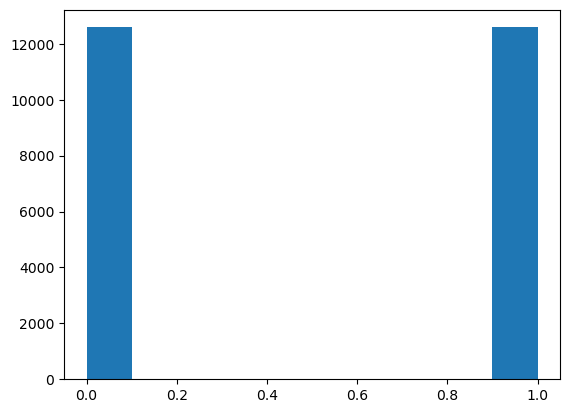

In [37]:
plt.hist(y_resampled.values)

## Evolutivo

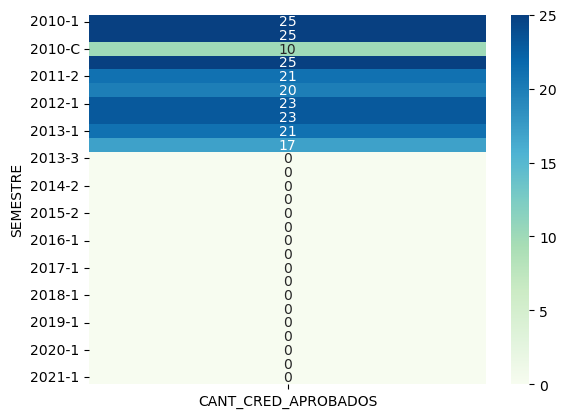

In [17]:
abc = df_alumno[['SEMESTRE','CANT_CRED_APROBADOS']]

abc = abc.set_index('SEMESTRE')

ax = sns.heatmap(abc, annot=True, cmap = 'GnBu')

In [18]:
data.head()

,SEMESTRE,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,SITUACION_MATRICULA,CANT_CURSOS_APROBADOS,CANT_CURSOS_DESAPROBADOS,CANT_CURSOS_NSP,CANT_CRED_APROBADOS,CANT_CRED_DESAPROBADOS,CANT_CRED_NSP,...,PUNT_EXAMEN_ADMINISION,MODAL_INGRESO,COLEGIO_PROCEDENCIA,TIPO_COLEGIO,SEXO_ESTUDIANTE,EDAD_INGRESANTE,DISTRITO_NAC,PROVINCIA_NAC,DEPARTAMENTO_NACIMIENTO,NUM_INGRESOS_UNIVERSIDAD
0,2010-1,alumno1,TURISMO,1,6,0,1,19.0,0.0,3.0,...,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,M,NaN,...,...,...,1
1,2010-2,alumno1,TURISMO,1,4,0,1,13.0,0.0,3.0,...,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,M,NaN,...,...,...,1
2,2010-C,alumno1,TURISMO,1,2,0,0,6.0,0.0,0.0,...,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,M,NaN,...,...,...,1
3,2011-1,alumno1,TURISMO,0,0,0,0,0.0,0.0,0.0,...,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,M,NaN,...,...,...,1
4,2011-2,alumno1,TURISMO,0,0,0,0,0.0,0.0,0.0,...,0,CONCURSO ORDINARIO DE ADMISIÓN,...,...,M,NaN,...,...,...,1


In [19]:
set(data['COD_ESTUDIANTE'])

{'alumno30167',
 'alumno8592',
 'alumno31847',
 'alumno6799',
 'alumno34173',
 'alumno8173',
 'alumno42011',
 'alumno11006',
 'alumno8520',
 'alumno44064',
 'alumno16148',
 'alumno16285',
 'alumno19563',
 'alumno34110',
 'alumno35533',
 'alumno13016',
 'alumno19096',
 'alumno28420',
 'alumno36911',
 'alumno20844',
 'alumno12883',
 'alumno26139',
 'alumno8378',
 'alumno1535',
 'alumno6683',
 'alumno44118',
 'alumno42872',
 'alumno35176',
 'alumno48655',
 'alumno2302',
 'alumno3637',
 'alumno6363',
 'alumno31783',
 'alumno40305',
 'alumno8662',
 'alumno43158',
 'alumno10986',
 'alumno20493',
 'alumno14649',
 'alumno26493',
 'alumno47542',
 'alumno25568',
 'alumno32754',
 'alumno703',
 'alumno17288',
 'alumno36202',
 'alumno15652',
 'alumno30827',
 'alumno39636',
 'alumno962',
 'alumno4715',
 'alumno26128',
 'alumno51697',
 'alumno27617',
 'alumno37400',
 'alumno35112',
 'alumno46125',
 'alumno35873',
 'alumno26456',
 'alumno38361',
 'alumno31621',
 'alumno7893',
 'alumno49526',
 'alumno8

In [20]:
df_resumen = data.groupby(['COD_ESTUDIANTE','ESCUELA_PROFESIONAL']).agg(NUM_MATRICULAS=('SITUACION_MATRICULA','sum'),
                                                  CURSOS_APROBADOS=('CANT_CURSOS_APROBADOS','sum'),
                                                  CURSOS_NO_APROBADOS=('CANT_CURSOS_DESAPROBADOS','sum'),
                                                  CREDITOS_APROBADOS=('CANT_CRED_APROBADOS','sum'),
                                                  CREDITOS_NO_APROBADOS=('CANT_CRED_DESAPROBADOS','sum'))
df_resumen = df_resumen.reset_index()

df_resumen.head()

,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,NUM_MATRICULAS,CURSOS_APROBADOS,CURSOS_NO_APROBADOS,CREDITOS_APROBADOS,CREDITOS_NO_APROBADOS
0,alumno1,TURISMO,3,12,0,38.0,0.0
1,alumno10,DERECHO,0,0,0,0.0,0.0
2,alumno100,CONTABILIDAD,1,2,0,7.0,0.0
3,alumno1000,ENFERMERIA,3,5,0,23.0,0.0
4,alumno10000,ECONOMIA,9,47,0,164.0,0.0


In [21]:
df_resumen[df_resumen['NUM_MATRICULAS']==10]

,COD_ESTUDIANTE,ESCUELA_PROFESIONAL,NUM_MATRICULAS,CURSOS_APROBADOS,CURSOS_NO_APROBADOS,CREDITOS_APROBADOS,CREDITOS_NO_APROBADOS
18,alumno10011,ENFERMERIA,10,38,4,152.0,25.0
30,alumno10022,INGENIERIA CIVIL,10,53,4,180.0,19.0
33,alumno10025,INGENIERIA CIVIL,10,53,3,181.0,15.0
39,alumno10030,INGENIERIA CIVIL,10,53,3,181.0,16.0
41,alumno10032,INGENIERIA CIVIL,10,51,2,173.0,12.0
...,...,...,...,...,...,...,...
52864,alumno9943,CONTABILIDAD,10,50,1,178.0,4.0
52896,alumno9972,DERECHO,10,64,0,210.0,0.0
52906,alumno9981,ECONOMIA,10,49,5,172.0,20.0
52916,alumno9990,ECONOMIA,10,46,9,161.0,32.0


In [22]:
hist_data = [df_resumen['NUM_MATRICULAS'].values]
group_labels = ['NUM_MATRICULAS'] # name of the dataset

fig = ff.create_distplot(hist_data, group_labels)

#fig.show()
fig.show(renderer="svg")

In [23]:
hist_data = [df_resumen['CURSOS_APROBADOS'].values,
            df_resumen['CURSOS_NO_APROBADOS'].values]
group_labels = ['CURSOS_APROBADOS','CURSOS_NO_APROBADOS'] # name of the dataset

fig = ff.create_distplot(hist_data, group_labels)


#fig.show()
fig.show(renderer="svg")


In [24]:
del fig